# AuxTel validation with simulated batoid data


Author: **Chris Suberlak** ([@suberlak](https://github.com/lsst-ts/ts_analysis_notebooks/issues/new?body=@suberlak))
<br>Last Verified to Run: **2022-04-12**
<br>Software Versions:
  - `ts_wep`: **v2.3.4**
  - `lsst_distrib`: **w_2022_15**
  
## Goal

Use simulated batoid data (courtesy of J. Meyers). These are numpy arrays, hence use actual AT FITS image headers for the metadata ansatz. The metadata is not used directly in the analysis, since we use `GenerateDonutDirectDetect` task to detect donuts with template fitting, which ignores the WCS data. We input FOCUSZ values so that one image is intra, and the other extra-focal (this is the only usage of FOCUSZ in the AOS pipeline for AT). The AT test data are exposures 2021032300308, 2021032300309, as used in https://github.com/lsst-ts/ts_externalscripts/blob/develop/tests/auxtel/test_latiss_cwfs_align.py#L222 and 
https://github.com/lsst-ts/ts_externalscripts/blob/develop/tests/auxtel/test_latiss_cwfs_align.py#L412
    



## Setup:
    
   * access to NCSA lsst-devl nodes 
   * working installation of ts_wep package ( see the following [notes](https://confluence.lsstcorp.org/display/LTS/Onboarding+to+LSST+AOS) for additional info on how to install and build the AOS packages)
    
It is assumed that `ts_analysis_notebooks` resides in `$PATH_TO_TS_ANALYSIS_NOTEBOOKS`. Here it was `/project/scichris/aos/ts_analysis_notebooks`.

At least once after cloning the `ts_analysis_notebooks` repo one needs to run the `setup` and `scons` commands. It can be  for example:
   
    cd $PATH_TO_TS_ANALYSIS_NOTEBOOKS
    setup -k -r .
    scons 

### Option A : using LSP 

After authenticating VPN, and opening a new machine on https://lsst-lsp-stable.ncsa.illinois.edu/ one can run this notebook on LSP, assuming that `lsst_distrib`, `ts_wep` and `ts_analysis_notebooks`  have been setup (for terminal commands such as pipetask), and same commands were added to the  `${HOME}/notebooks/.user_setups`  file that is sourced when starting the `LSST` jupyter kernel, for instance:
    
    setup lsst_distrib
    setup ts_wep -t $USER  -k -r /project/scichris/aos/ts_wep/
    setup ts_analysis_notebooks -k -r 
    
### Option B: tunneling jupyter notebook to a browser via SSH

Setup (that was used to run the analysis on a notebook opened in a browser using an ssh connection to the NCSA machine). Here `scichris` is my username, and `/project/scichris/aos/setup_aos_current.sh` the setup script that loads the AOS packages. In particular, the `ts_wep` installation used was `/project/scichris/aos/ts_wep` . The `54467` can be any other port number, as long as it is consistent between `ssh` connection and the jupyter notebook.
    
Run in the terminal on the local machine:

    ssh -L 54467:localhost:54467 scichris@lsst-devl02
    
Run in the NCSA terminal after DUO authentication (I aliased these in `~/.bash_profile`:

    source "/software/lsstsw/stack/loadLSST.bash"
    setup lsst_distrib     # first two aliased with "lsst"
    
    source /project/scichris/aos/setup_aos_current.sh  # aliased as "aos"
    
    setup -k -r $PATH_TO_TS_ANALYSIS_NOTEBOOKS
    
    jupyter notebook --no-browser --port=54467         # aliased as "jup" 
   
This should open the browser at the NCSA `/jhome` directory.  I navigate to `$PATH_TO_TS_ANALYSIS_NOTEBOOKS` to open this notebook.


## Imports

In [1]:
from astropy.io import fits
from astropy.visualization import ZScaleInterval
from astropy.table import Table

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import matplotlib as mpl
from matplotlib import rcParams 

import os
import numpy as np
from copy import copy
import yaml

from lsst.ts.wep.task.EstimateZernikesLatissTask import (EstimateZernikesLatissTask, 
EstimateZernikesLatissTaskConfig)
from lsst.ts.wep.task.GenerateDonutDirectDetectTask import (
GenerateDonutDirectDetectTask, GenerateDonutDirectDetectTaskConfig
)
from lsst.ts.wep.Utility import DefocalType
from lsst.ts.wep.DonutDetector import DonutDetector

In [2]:
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18


## Show the simulated data 

In [3]:
!ls /home/jemeyers/AuxTelSims/M2-rigid/

Explore.ipynb	extra_007.fits	intra_005.fits	sim_003.yaml
extra_000.fits	extra_008.fits	intra_006.fits	sim_004.yaml
extra_001.fits	extra_009.fits	intra_007.fits	sim_005.yaml
extra_002.fits	intra_000.fits	intra_008.fits	sim_006.yaml
extra_003.fits	intra_001.fits	intra_009.fits	sim_007.yaml
extra_004.fits	intra_002.fits	sim_000.yaml	sim_008.yaml
extra_005.fits	intra_003.fits	sim_001.yaml	sim_009.yaml
extra_006.fits	intra_004.fits	sim_002.yaml	sim_at_m2_rigid.py


The `sim_xxx.yaml` files have input settings and true Zernike coefficients (for wavelength of 620 nm).

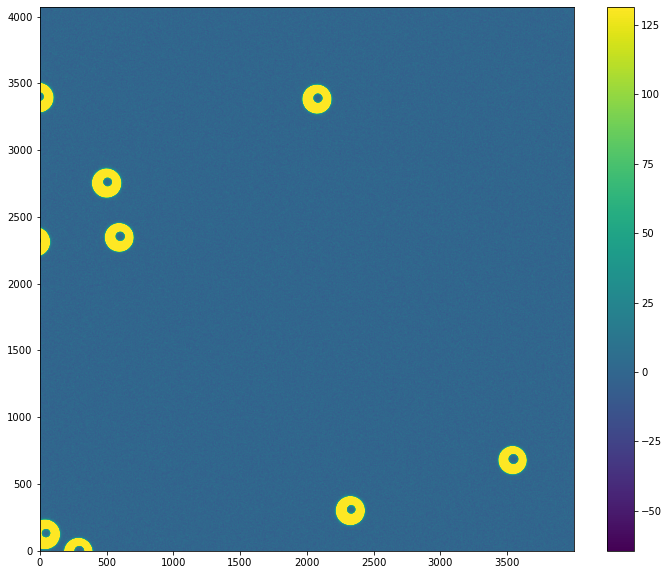

In [32]:
%matplotlib inline
hdula = fits.open('/home/jemeyers/AuxTelSims/M2-rigid/extra_000.fits')
fig = plt.figure(figsize=(12, 10))
zscale = ZScaleInterval()
data = hdula[0].data
vmin, vmax = zscale.get_limits(data)
plt.imshow(data, origin='lower',vmin=vmin,vmax=vmax)
plt.colorbar()

I need to run ISR, because raw images have a different dimension than the postISR. The dimension of raw data is `(4096, 4608)` , and postISR `(4000, 4072)`, which matches the simulation. This got executed to create the postISR data:

    ssh lsst-devl02

    source "/software/lsstsw/stack/loadLSST.bash"
    setup lsst_distrib

    pipetask run  --data-query "exposure IN (2021032300307,2021032300308,2021032300309,2021032300310,2021032300311) AND instrument='LATISS' " -b /repo/main/butler.yaml --input  LATISS/raw/all,LATISS/calib,u/czw/DM-28920/calib.20210720  --output u/$USER/Latiss/postISRtest --pipeline /project/scichris/aos/testLatiss4.yaml  --register-dataset-types

## Run all simulated files in a loop 

In [65]:
# import all tasks and modules beforehand
donutDetectConfig = GenerateDonutDirectDetectTaskConfig(donutTemplateSize = 200,
                                            instName = 'auxTel',
                                            opticalModel = 'onAxis',
                                            peakThreshold = 0.99,
                                            binaryChoice = 'deblend') # adaptative image thresholding
donutDetectTask = GenerateDonutDirectDetectTask(config=donutDetectConfig)


estimateZernikeConfig = EstimateZernikesLatissTaskConfig(donutStampSize=200, 
                                                         donutTemplateSize=200,
                                                         opticalModel='onAxis')
estimateZernikeTask = EstimateZernikesLatissTask(config=estimateZernikeConfig)


In [7]:
def fit_simulation_files(i, exp_intra, exp_extra, camera, donutDetectTask, estimateZernikeTask,
                         source='M2-rigid', path_to_simulation='/home/jemeyers/AuxTelSims', 
                         path_to_results='/project/scichris/aos/AOS'):
    #source =  'Z4-Z22'  'Z4-Z11'  M2-rigid' 
    
    # the numerical portion of each exposure image array 
    # is replaced by the simulation data
    hdul1 = fits.open(os.path.join(path_to_simulation, f'/{source}/extra_00{i}.fits'))
    exp_extra.image.array[:] = np.transpose(hdul1[0].data)
    
    hdul2 = fits.open(os.path.join(path_to_simulation, f'/{source}/intra_00{i}.fits'))
    exp_intra.image.array[:] = np.transpose(hdul2[0].data)
    
    # detect donuts in the intra exposure; 
    # the location is the same as extra exposure
    donutCatalog = donutDetectTask.run(exp_intra)
    donutCat = donutCatalog.donutCatalog

    # declare the exposure pair
    exposure_pair = [exp_intra, exp_extra ]

    # run Zernike estimation
    zernikeOutput = estimateZernikeTask.run(exposure_pair, [donutCat], camera)

    # store the results
    zernikes = zernikeOutput.getDict()
    fname = os.path.join(path_to_results, f'zerDic_{source}_{i}_N.npy')
    np.save(fname,zernikes)
    print(f'Stored the results as {fname} ')


In [68]:
# Read the real postISR data in only once
repo_dir = '/repo/main/'
butler = dafButler.Butler(repo_dir)

datasetType = 'postISRCCD'
collection = 'u/scichris/Latiss/postISRtest'
instrument='LATISS'
dataId = {'instrument': instrument , 'detector': 0, 'exposure': 2021032300307}
exp_extra = butler.get(datasetRefOrType=datasetType, 
                       dataId=dataId,
                       collections=[collection]
                      )

dataId = {'instrument': instrument, 'detector': 0, 'exposure': 2021032300308}
exp_intra = butler.get(datasetRefOrType=datasetType, 
                       dataId=dataId,
                       collections=[collection]
                      )

# get the camera from butler
camera = butler.get("camera",dataId={"instrument": instrument}, 
                        collections=[collection],)

Fit all simulation data:

In [ ]:
for source in ['Z4-Z22', 'Z4-Z11','M2-rigid']: 
    for i in range(10):
        fit_simulation_files(i, exp_intra, exp_extra, 
                             camera, donutDetectTask, 
                             estimateZernikeTask,
                             source=source)

## Results



Plot raw Zernike fit, the truth (input to the simulation), location of donuts, and donut postage stamps:

In [13]:
def plot_simulation_results(source='Z4-Z22', iNum=0, 
                            path_to_simulation='/home/jemeyers/AuxTelSims', 
                            path_to_results='/project/scichris/aos/AOS'
                           ):
    # read the truth 
    fpath = os.path.join(path_to_simulation, f'{source}/sim_00{iNum}.yaml')

    with open(fpath) as fh:
        truth = yaml.safe_load(fh)

    zkSim = truth['zern']

    # read the fit results 
    zkResultsFile = os.path.join(path_to_results, f'zerDic_{source}_{iNum}_N.npy')
    #if source == 'M2-rigid':
    #    zkResultsFile = f'zerDic{iNum}.npy'
    zkFit = np.load(zkResultsFile, allow_pickle=True).item()
    
    # choose just one since two are stored so that 
    # the number of input connections (two exposures)
    # matches the number of output connections
    # (two identical sets of zks and donut stamps)
    rawZks = zkFit['outputZernikesRaw'][0]
    
    # plot the figure ...   
    fig = plt.figure(figsize=(14, 5))
     
    ####################################
    ### left - plot the fit results  ###
    #################################### 
        
    #add_axes([xmin,ymin,dx,dy]) 
    ax1 = fig.add_axes([0,0,0.6,1])  

    for i in range(len(rawZks)):
        ax1.plot(np.arange(4, 23),rawZks[i], 
                 '-d', label=f'donut {i}')
        ax1.set_xlabel('Zernike Number', size=14)
        ax1.set_ylabel('Avg Zernike Coefficient (microns)', size=14)
    
    # this is to correct for the fact that the 
    # stored 'truth' in the yaml file has the
    # opposite sign fir the first two sets 
    if source == 'Z4-Z22' or source == 'Z4-Z11':
        multiplyFactor = -1 
    elif source == 'M2-rigid':
        multiplyFactor = 1 
        
    ax1.plot(np.arange(4,23), multiplyFactor*np.array(zkSim[4:]), 
             c='red',lw=10,alpha=0.5, markersize=14,
             label='truth')
    
    ax1.legend(fontsize=14, loc='center left', bbox_to_anchor=[1., 0.5])
    ax1.set_title(f'Simulation {source}, i=00{iNum}', fontsize=18)
    ax1.set_xticks(np.arange(4,23)[::2])
    ax1.grid()
    
    ###############################################
    ### right - plot the simulated donuts image ###
    ###############################################
    
    
    ax2 = fig.add_axes([0.7,0,0.4,1])

    # open the simulated image 
    hdul = fits.open(os.path.join(path_to_simulation, f'{source}/intra_00{iNum}.fits'))
    data = np.transpose(hdul[0].data)

    # get the vmin, vmax 
    zscale = ZScaleInterval()
    vmin, vmax = zscale.get_limits(data)

    ax2.imshow(data, origin='lower', vmin=vmin, vmax=vmax)
    donutStampsExtra = zkFit['donutStampsExtra'][0]
    nrows = len(donutStampsExtra)
    for i in range(nrows):
        donut = donutStampsExtra[i]
        xy = donut.centroid_position

        # plot the cross marking that the donut was used 
        ax2.scatter(xy[0],xy[1],s=200,marker='+',c='m', lw=4)

        # plot the donut number on the plot 
        xtext,ytext = xy[0],xy[1]
        ytext -= 60
        if xtext+100 > 4096:
            xtext -= 250
        if len(str(i))>1: # move to the left label thats too long 
            #print(i, 'moving')
            xtext -=340 
        else:
            xtext -=260
        ax2.text(xtext, ytext, f'{i}', fontsize=17, c='white' )    
    ax2.yaxis.tick_right()
    ax2.set_xlabel('x [px]')
    ax2.set_ylabel('y [px]')
    ax2.yaxis.set_label_position("right")
    
    nDonuts = len(donutStampsExtra)
    ncols=4
    nrows= nDonuts//ncols
    if nrows*ncols<nDonuts:
        nrows+=1
    fig,axs = plt.subplots(nrows, ncols, figsize=(3*ncols, 3*nrows))
    ax = np.ravel(axs)
    for i in range(nDonuts):
        donut = donutStampsExtra[i]
        ax[i].imshow(donut.stamp_im.image.array, origin='lower')
        ax[i].text(80,80, f'{i}', fontsize=17, c='white')
    fig.subplots_adjust(hspace=0.35)  
    
    # if there are more axes than donuts,
    # turn off the extra axes 
    ncells = nrows*ncols
    if ncells > nDonuts:
        for axis in ax[nDonuts:]:
            axis.axis("off")
            
            
    # save the plot 
    plt.savefig(f'simulation_{source}_{iNum}.png', bbox_inches='tight')

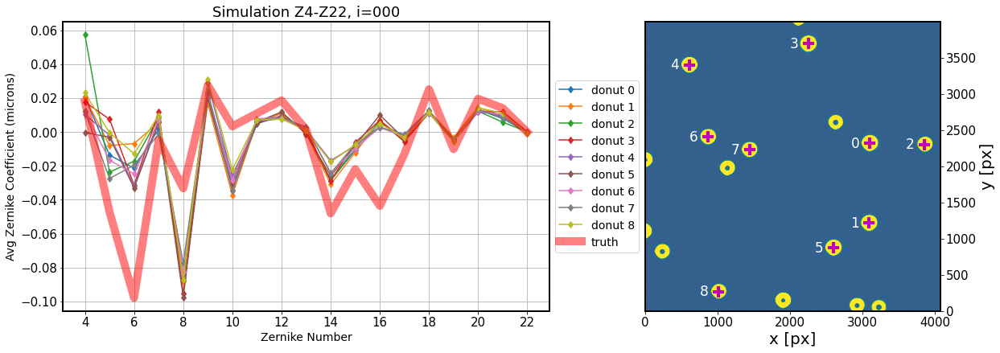

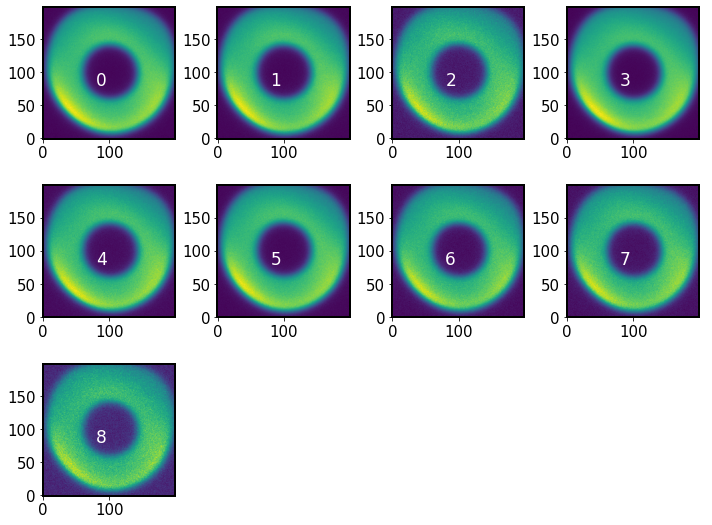

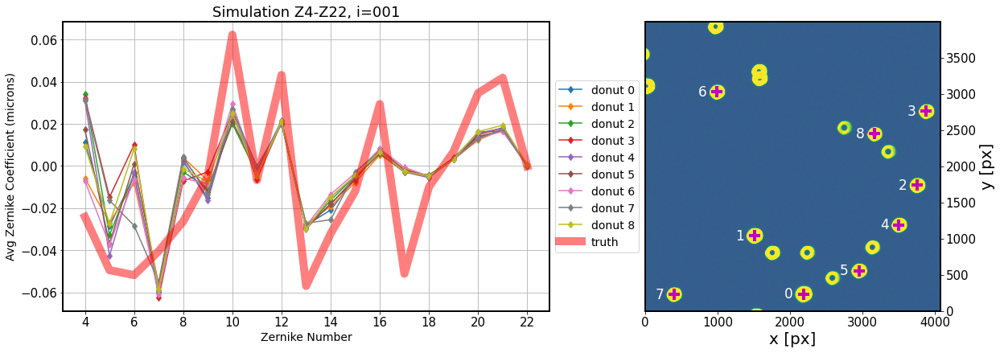

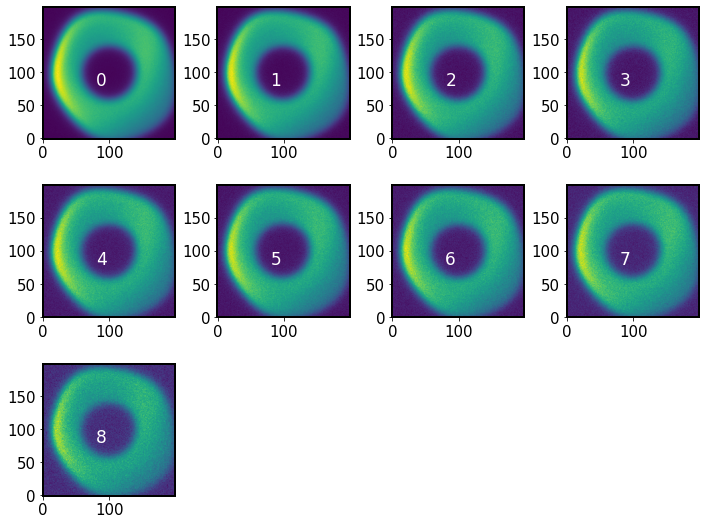

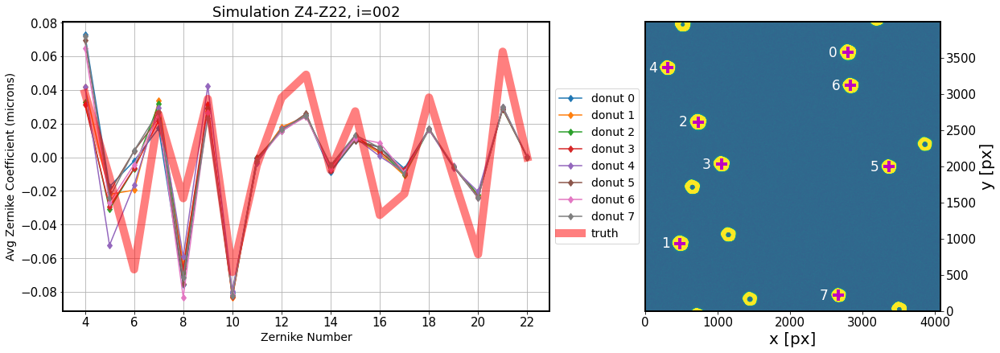

...

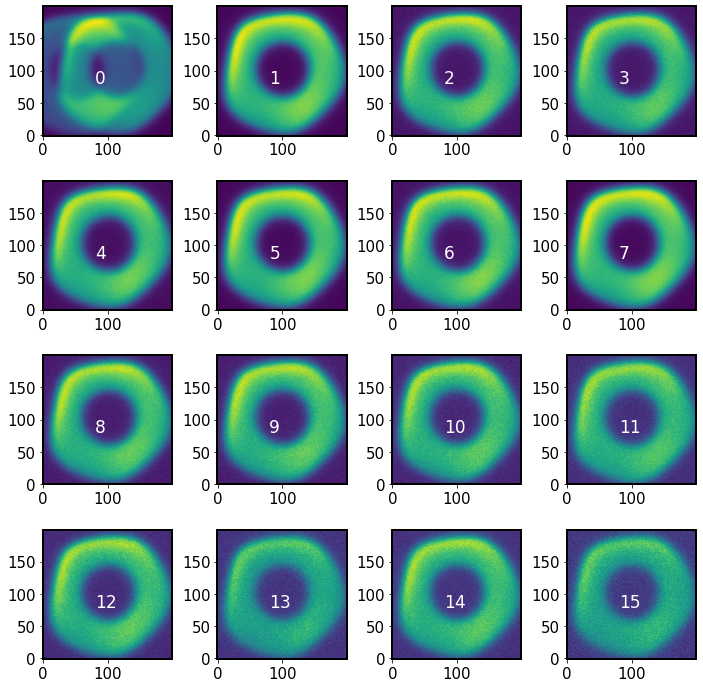

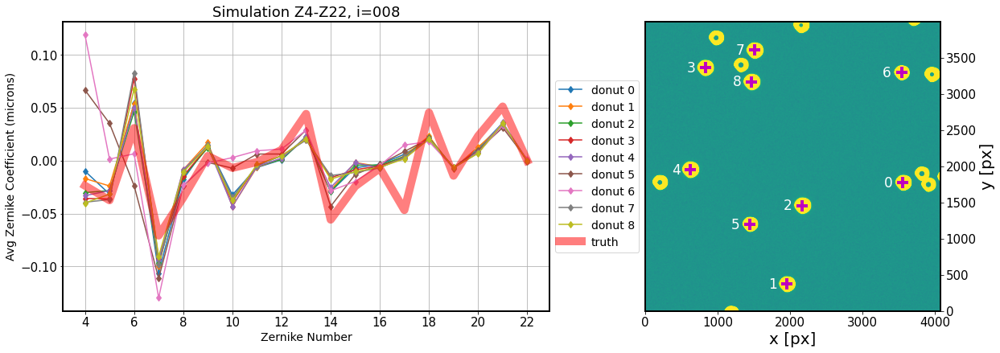

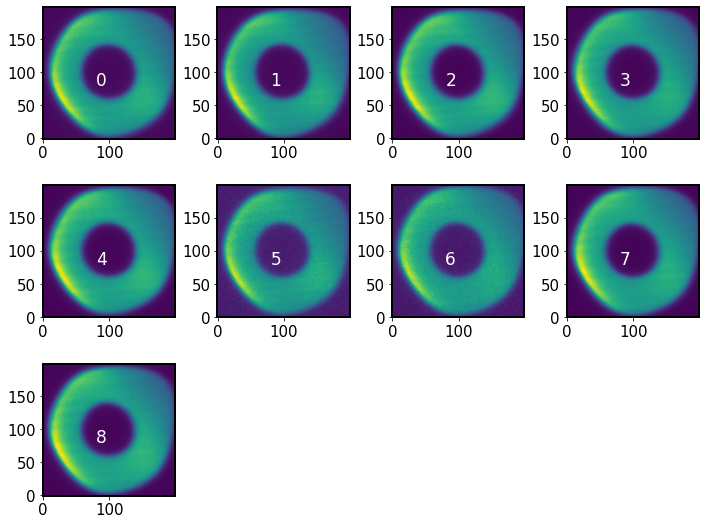

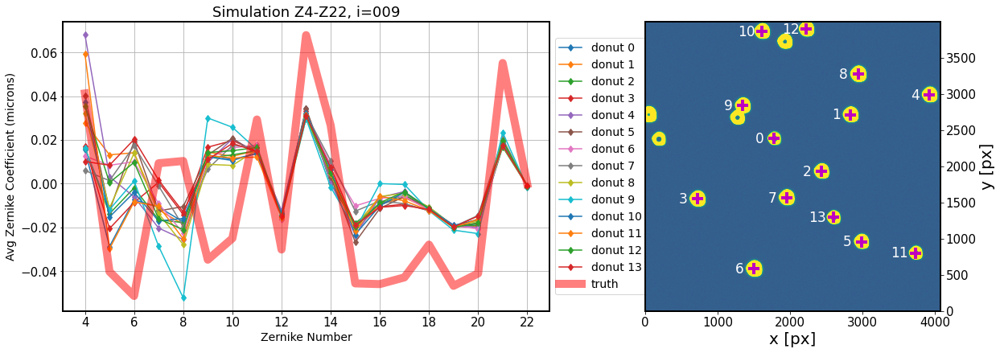

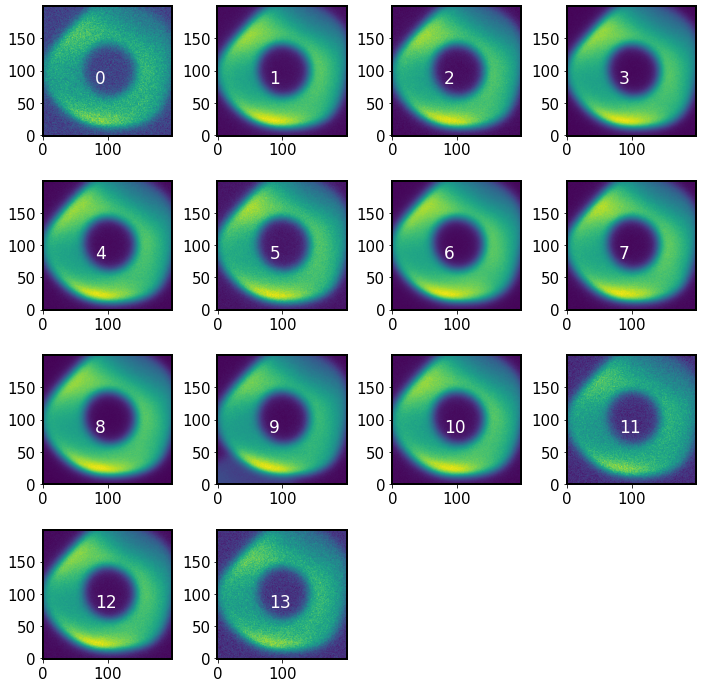

In [16]:
%matplotlib inline
for i in range(10):
    plot_simulation_results(source='Z4-Z22', iNum=i)

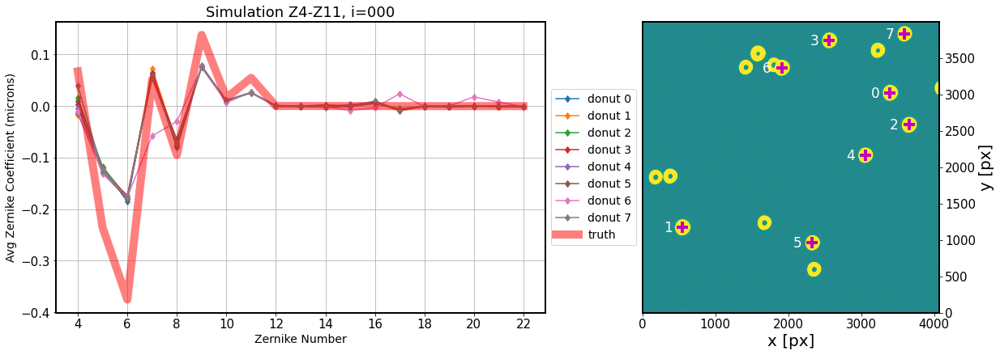

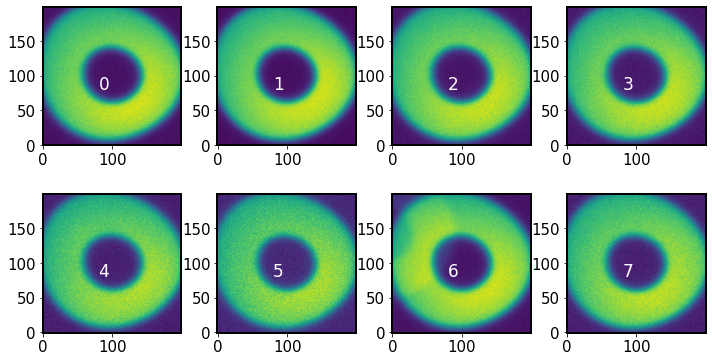

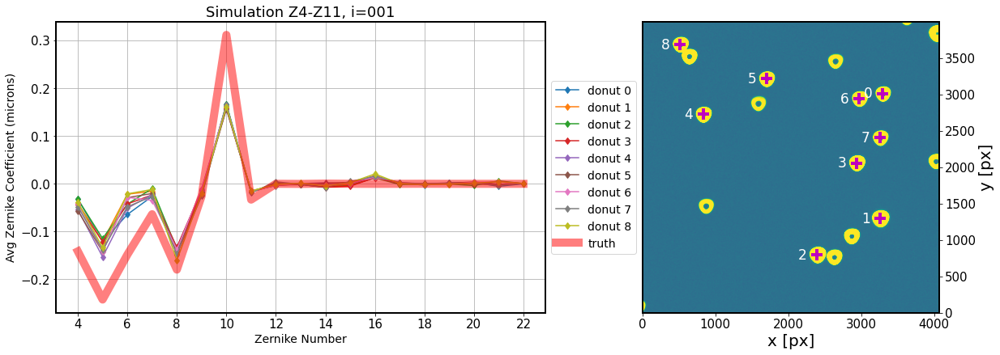

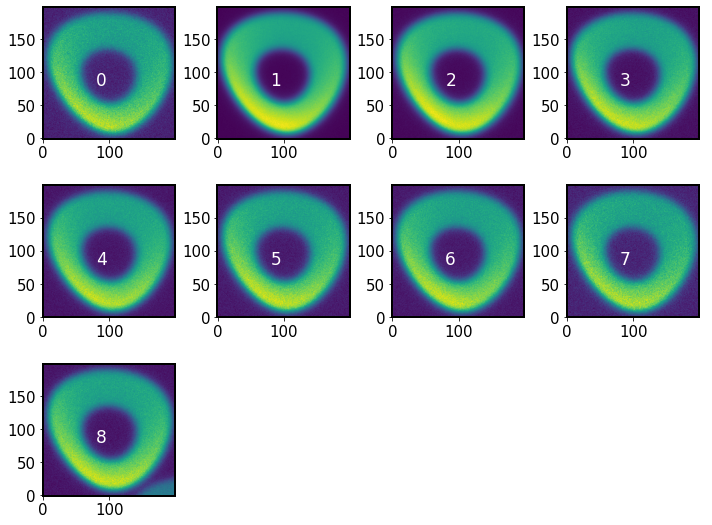

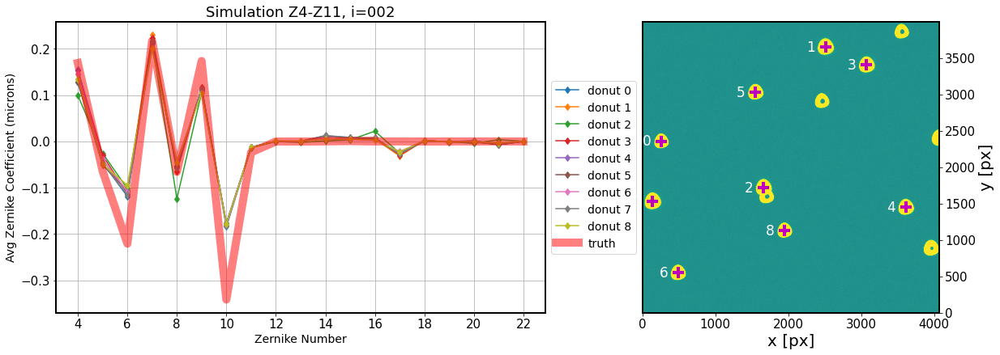

...

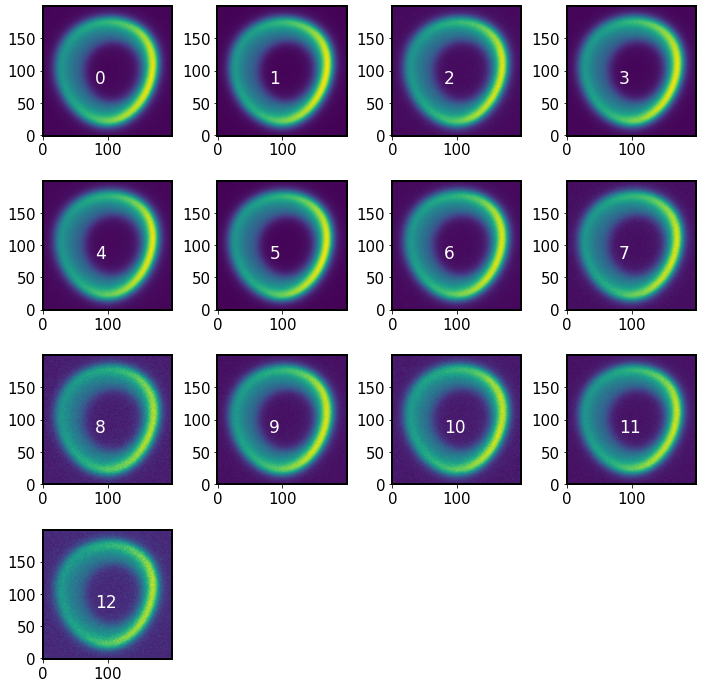

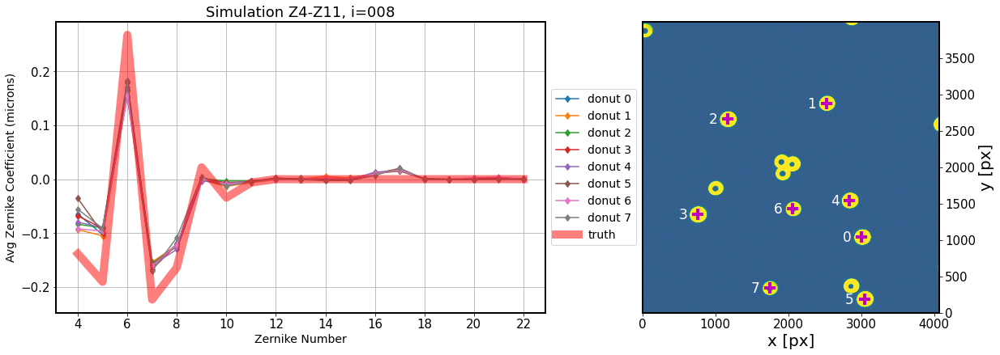

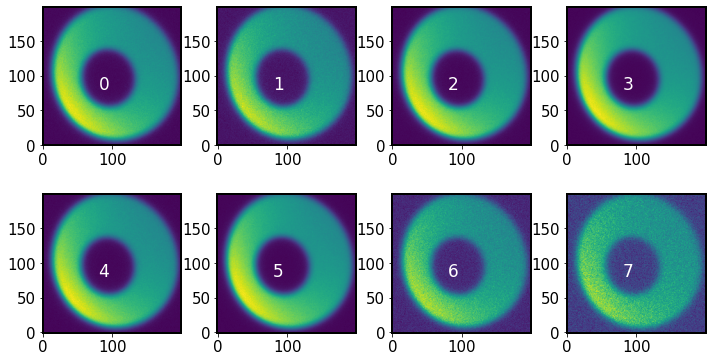

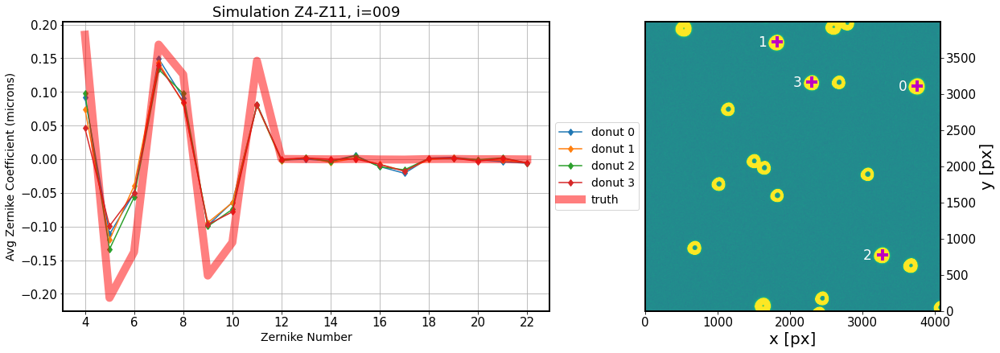

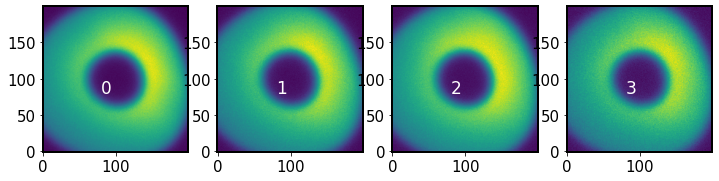

In [17]:
for i in range(10):
    plot_simulation_results(source='Z4-Z11', iNum=i)

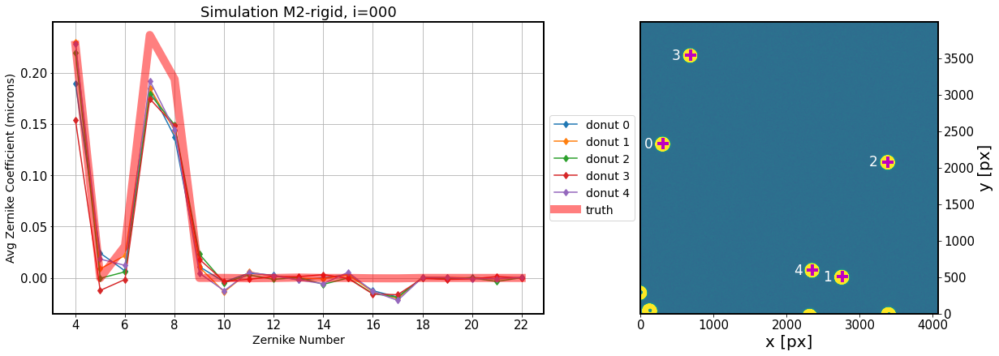

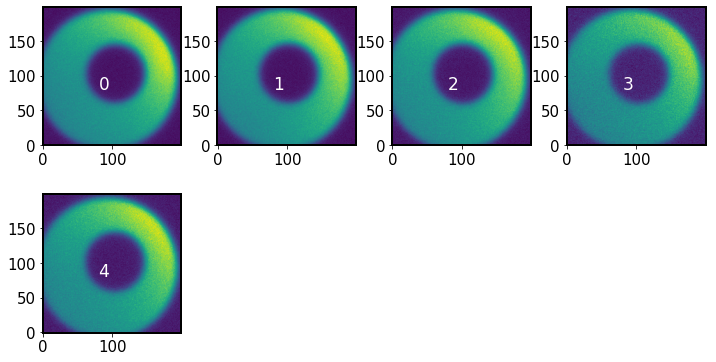

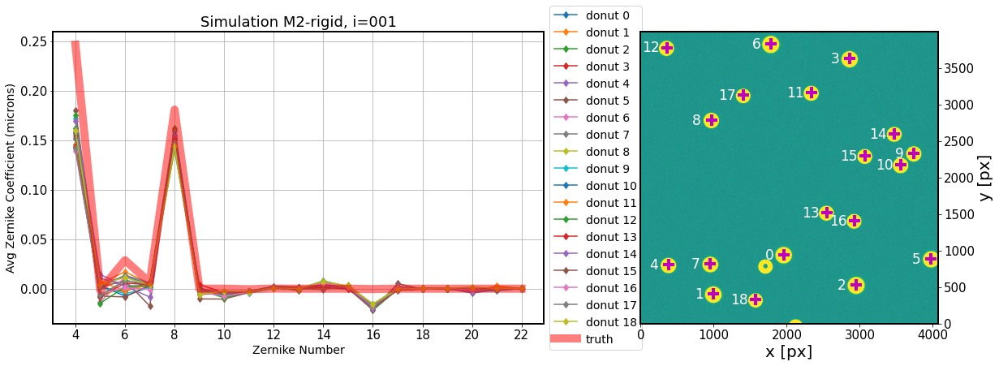

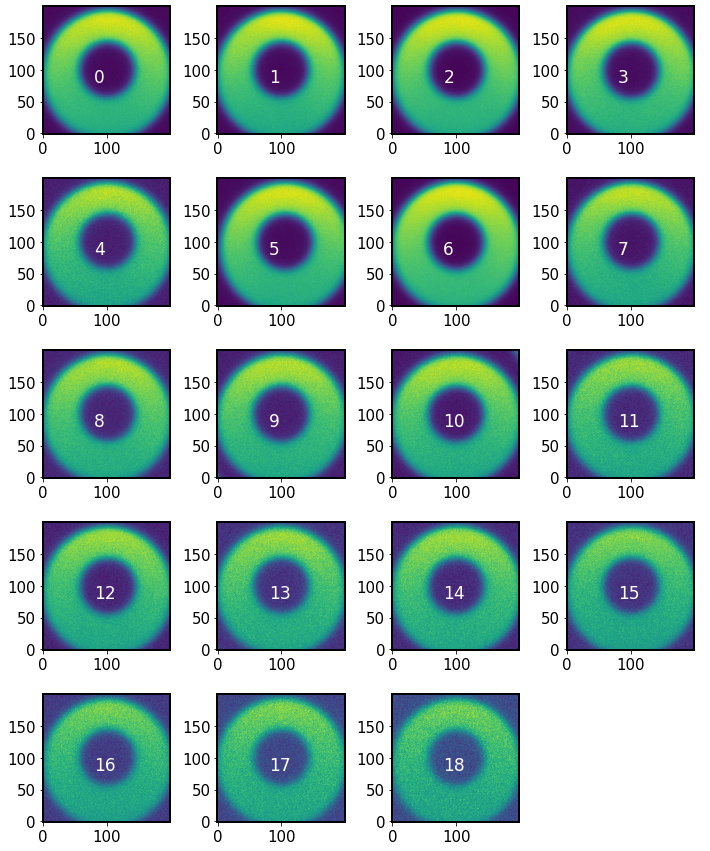

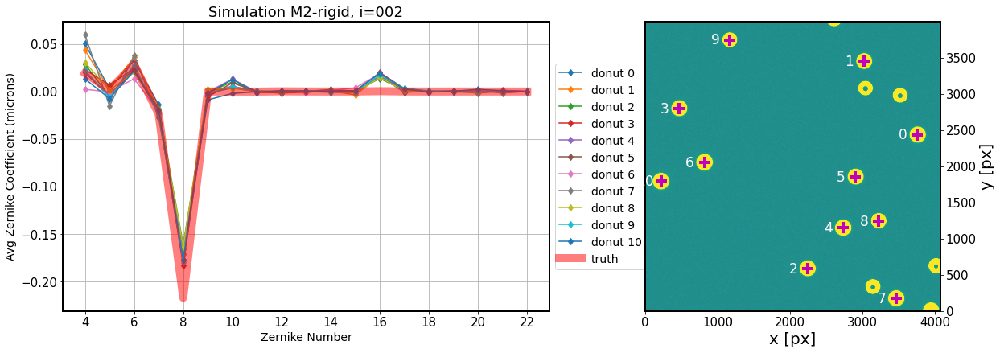

...

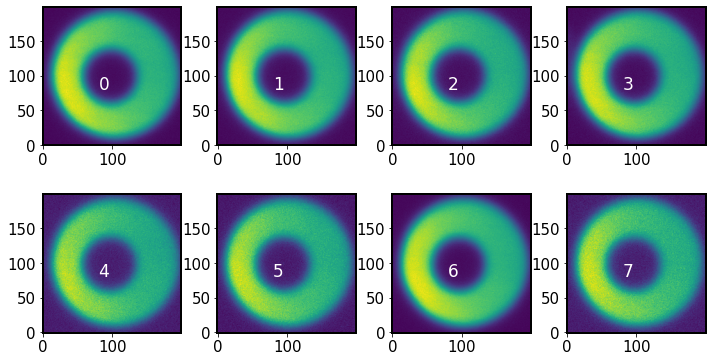

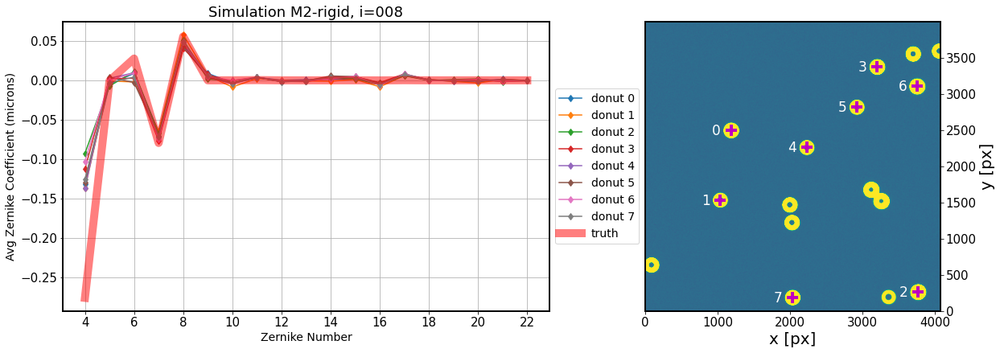

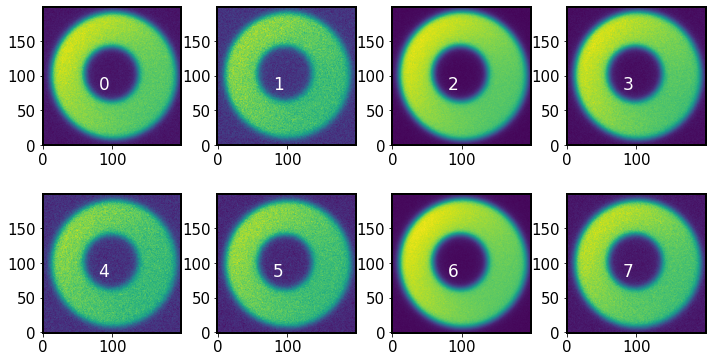

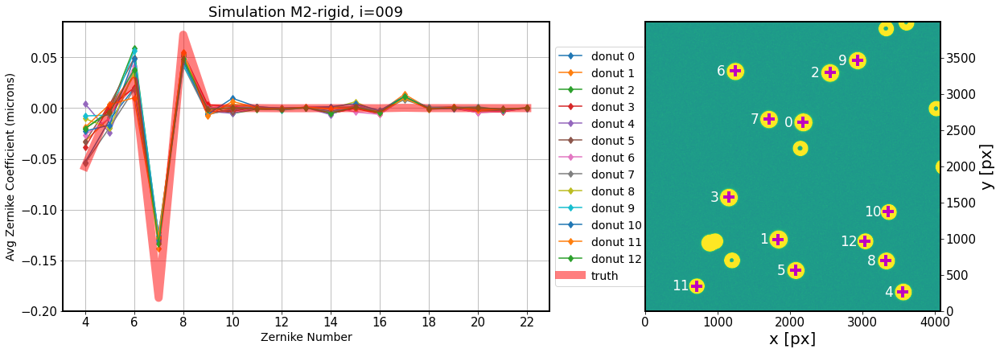

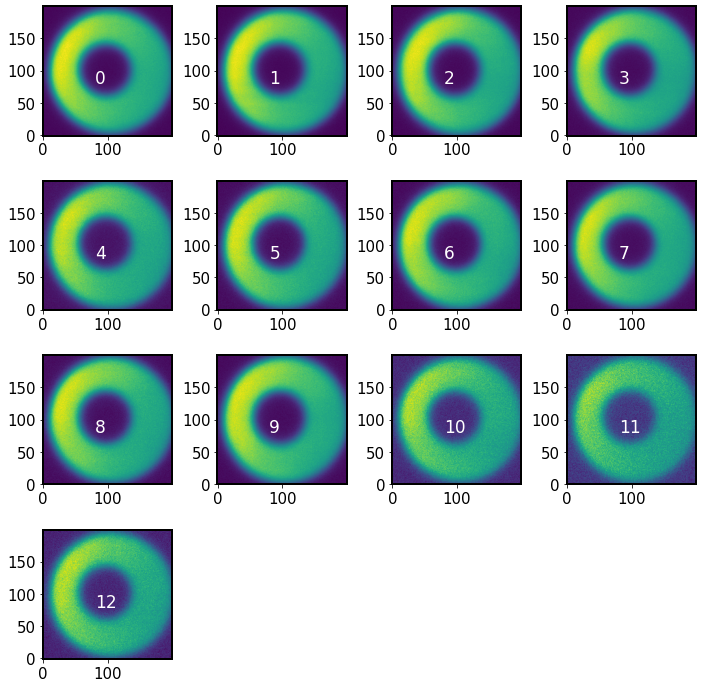

In [18]:
for i in range(10):
    plot_simulation_results(source='M2-rigid', iNum=i)

## Summarize 

Notice that in the above, the "bad" donuts are always unrecognized blends (since the algorithm should reject the blends). This is the case for:

   * `Z4-Z22`:
     * i=7, donut0, 
     * i=9, donut 9
   * `Z4-Z11`:
     * i=5, donuts 0,11,
     * i=6, donut 0
   * `M2-rigid`:
     * i=6, donut 6
     
Also, for two exposures the number of detected donuts is very low (`Z4-Z11`, `i=6`, and `i=9`). This could be because the threshold for adaptative fitting is too high. 

In [4]:
bad_donuts = {'Z4-Z22':{7:[0], 9:[9]},   # 'simulation setup':{iNum:[list of donuts to ignore]}
              'Z4-Z11':{5:[0,11], 6:[0]},
              'M2-rigid':{6:[6]}
             }


Read in the truth and the results:

In [5]:
path_to_results='/project/scichris/aos/AOS'

results = {}
for source in ['Z4-Z22','Z4-Z11', 'M2-rigid']:
    results[source] = {}
    for iNum in range(10):
        results[source][iNum]={}

        # read the fit results 
        zkResultsFile = os.path.join(path_to_results, f'zerDic_{source}_{iNum}_N.npy')
        
        #if source == 'M2-rigid':
        #    zkResultsFile = f'zerDic{iNum}.npy'
        zkFit = np.load(zkResultsFile, allow_pickle=True).item()

        # choose just one since two are stored so that 
        # the number of input connections (two exposures)
        # matches the number of output connections
        # (two identical sets of zks and donut stamps)
        rawZks = zkFit['outputZernikesRaw'][0]

        if iNum in bad_donuts[source].keys():
            bad_donuts_ids = bad_donuts[source][iNum]
            print(f'For {source}, iNum={iNum}, bad donuts are {bad_donuts_ids}')

            # loop over raw zks and keep only the good ones
            keepZks =  []
            for i in range(len(rawZks)):
                if i in bad_donuts_ids: # don't append the bad ones 
                    continue
                keepZks.append(rawZks[i])

        else:
            keepZks = rawZks

        results[source][iNum]=keepZks

For Z4-Z22, iNum=7, bad donuts are [0]
For Z4-Z22, iNum=9, bad donuts are [9]
For Z4-Z11, iNum=5, bad donuts are [0, 11]
For Z4-Z11, iNum=6, bad donuts are [0]
For M2-rigid, iNum=6, bad donuts are [6]


In [6]:
path_to_simulation='/home/jemeyers/AuxTelSims'

# store truth in a similar dic
truth = {}
for source in ['Z4-Z22','Z4-Z11', 'M2-rigid']:
    truth[source] = {}
    
    # need to introduce a multiplicative factor because
    # truth for Z4-Z22 and Z4-Z11 has opposite sign 
    # to the fit result convention 
    if source == 'Z4-Z22' or source == 'Z4-Z11':
        multiplyFactor = -1 
    elif source == 'M2-rigid':  
        multiplyFactor = 1 
        
    for iNum in range(10):
        # read the truth 
        fpath =os.path.join(path_to_simulation, f'{source}/sim_00{iNum}.yaml')

        with open(fpath) as fh:
            true_result = yaml.safe_load(fh)

        zkSim = true_result['zern']
        
        # keep just zks 4:22
        truth[source][iNum] =  multiplyFactor*np.array(zkSim[4:]) 
             

Given `truth` and `results` dictionaries, calculate the median and residuals

In [84]:
stats = {}
for source in ['Z4-Z22','Z4-Z11', 'M2-rigid']:
    stats[source] = {}
    for iNum in range(10):
        stats[source][iNum] = {}
        
        # calculate median 
        median =  np.median(results[source][iNum],axis=0) 
        stats[source][iNum]['median'] = median # median across all donuts, len=19
        
        # calculate the residuals
        input_value = truth[source][iNum]
        residual = median - input_value
        stats[source][iNum]['residual'] = residual
        
        # calculate the RMS residual to compare to Manuel+2010
        # a single number per simulation
        rms = np.sqrt(np.mean(np.square(residual)))
        stats[source][iNum]['rms'] = rms 
        
        # calculate the RMS error
        zernikeErrorsDiff = np.sqrt((results[source][iNum]-input_value)**2.)
        zernikeErrors = np.transpose(zernikeErrorsDiff, axes=(1,0))
        zernikeRms = np.sqrt(np.mean(np.square(zernikeErrors), axis=1))
        stats[source][iNum]['rms_err'] = zernikeRms 
        

In [97]:
def plot_residuals(stats, source='Z4-Z22'):
    # plot the figure ...   
    fig = plt.figure(figsize=(14, 5))

    ax1 = fig.add_axes([0,0,0.6,1])  
    
    # calculate mean residual, sort by that 
    means = []
    rmss = []
    for iNum in range(10):
        mean_residual = np.abs(np.mean(stats[source][iNum]['residual']))
        means.append(mean_residual)
        rmss.append(stats[source][iNum]['rms'])
    
    res = Table(data=[means, rmss, np.arange(10)], names=['mean','rms', 'iNum'])
    res.sort('mean')

    n_lines = 10
    color_idx = np.linspace(0, 1, n_lines)
    i=0
    cmap = plt.cm.viridis
    for iNum in res['iNum']:
        color = cmap(color_idx[i])
        mean = res['mean'][i]
        ax1.plot(np.arange(4, 23), stats[source][iNum]['residual'], '-d', 
                 c=color,
                 label=f'i={iNum} ')
    
        line = mlines.Line2D([], [], color=color, ls='-', marker='o', alpha=1,
                                 )
    
        i+=1
    ax1.set_xlabel('Zernike Number', )
    ax1.set_ylabel('Truth-Median Raw Zks (microns)',)
        
    ax1.set_xticks(np.arange(4,23)[::2])
    ax1.legend(title='simulation', bbox_to_anchor=[1.02, 0.9],ncol=1)
    ax1.set_title(f"{source},  mean residual={1000*np.mean(res['mean']):.2f}[nm]", fontsize=18)
    
    # convert microns to nanometers 
    bounds = 1000*np.linspace(min(res['mean']), max(res['mean'])) 
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='max')

    #add_axes has the signature ([xmin,ymin,dx,dy]) 
    cax = fig.add_axes([0.73,0,0.02,1])
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
                 cax=cax, orientation='vertical',
                       format='%.2f'
                       )

    cbar.ax.tick_params(labelsize=15,)
    cbar.set_label(label=  r"$|\langle residual \rangle | \,\, [nm]$", size=18)



In [109]:
def plot_rms(stats, source='Z4-Z22', xpos=1.03):
    # plot the figure ...   
    fig = plt.figure(figsize=(14, 5))

    ax1 = fig.add_axes([0,0,0.6,1])  
    
    # calculate rms, sort by that 
    means = []
    rmss = []
    meanrms = []
    for iNum in range(10):
        mean_residual = np.abs(np.mean(stats[source][iNum]['residual']))
        mean_rms_err = np.mean(stats[source][iNum]['rms_err'])
        means.append(mean_residual)
        rmss.append(stats[source][iNum]['rms'])
        meanrms.append(mean_rms_err)
        
    res = Table(data=[means, rmss, meanrms, np.arange(10)], 
                names=['mean','rms', 'meanrmserr', 'iNum'])
    res.sort('meanrmserr')

    n_lines = 10
    color_idx = np.linspace(0, 1, n_lines)
    i=0
    cmap = plt.cm.viridis
    for iNum in res['iNum']:
        color = cmap(color_idx[i])
        rms = res['meanrmserr'][i]
        
        ax1.plot(np.arange(4, 23), stats[source][iNum]['rms_err'], '-d', 
                 c=color,
                 label=f'i={iNum} ')
    
        line = mlines.Line2D([], [], color=color, ls='-', marker='o', alpha=1,
                                 )
    
        i+=1
    ax1.set_xlabel('Zernike Number', )
    ax1.set_ylabel('RMS Zk error (microns)',)
        
    ax1.set_xticks(np.arange(4,23)[::2])
    ax1.legend(title='simulation', bbox_to_anchor=[xpos, 0.9], ncol=1)
    ax1.set_title(f"{source},  mean rms err ={1000*np.mean(res['meanrmserr']):.2f}[nm]", fontsize=18)
    
    # convert microns to nanometers 
    bounds = 1000*np.linspace(min(res['meanrmserr']), 
                              max(res['meanrmserr'])
                             ) 
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='max')

    #add_axes has the signature ([xmin,ymin,dx,dy]) 
    cax = fig.add_axes([0.73,0,0.02,1])
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
                 cax=cax, orientation='vertical',
                       format='%.2f'
                       )

    cbar.ax.tick_params(labelsize=15,)
    cbar.set_label(label=  r"$|\langle rms \rangle | \,\, [nm]$", size=18)



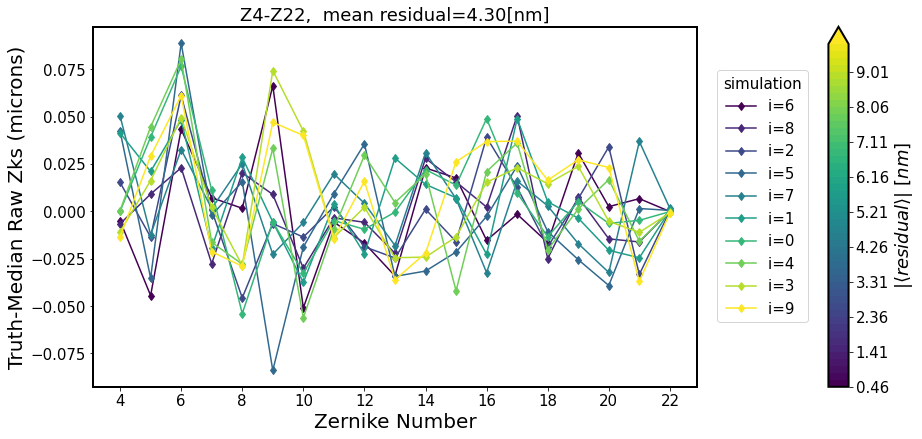

In [99]:
%matplotlib inline
rcParams['legend.fontsize'] = 15
rcParams["legend.title_fontsize"] = 15
plot_residuals(stats)

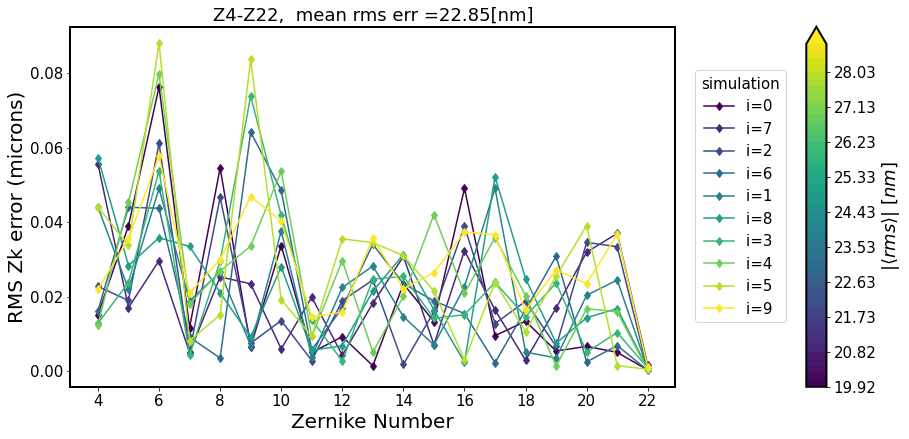

In [100]:
plot_rms(stats)

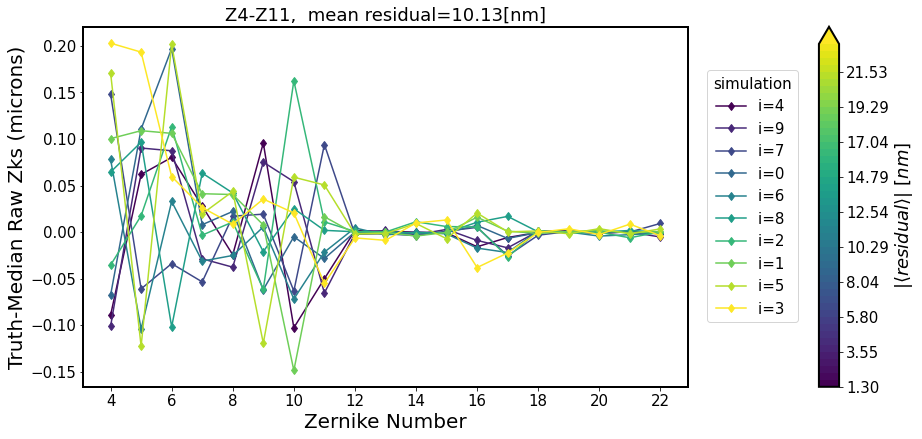

In [101]:
plot_residuals(stats, source='Z4-Z11')


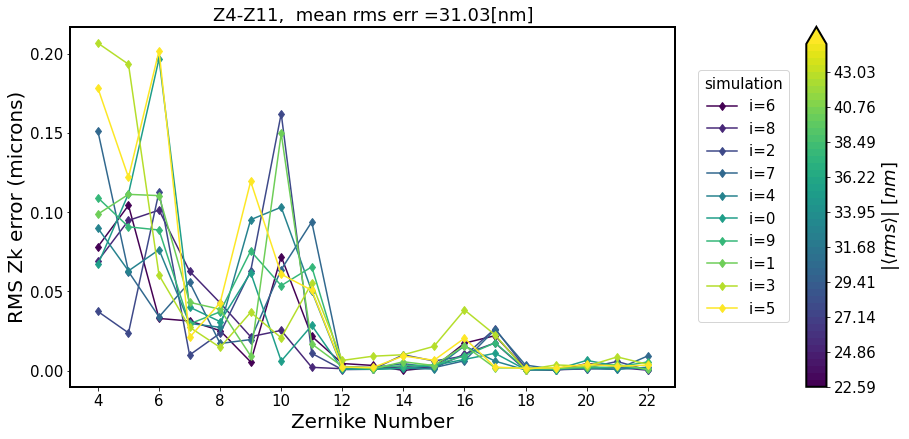

In [110]:
plot_rms(stats, source='Z4-Z11', xpos=1.2)

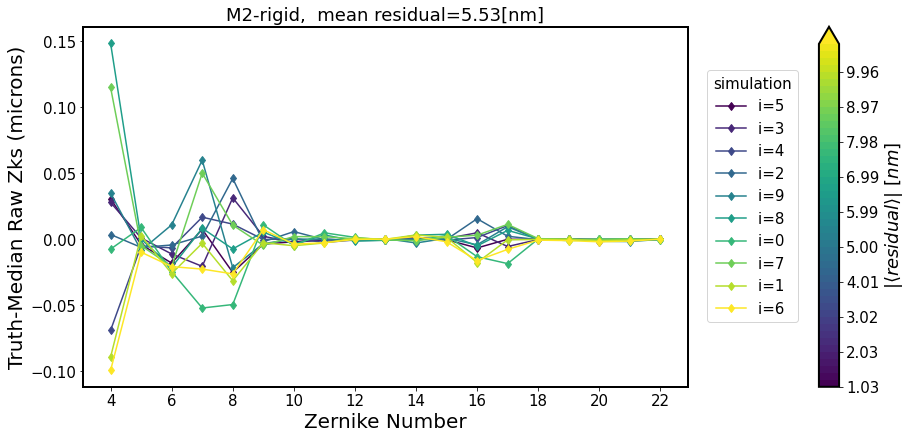

In [111]:
plot_residuals(stats, source='M2-rigid')


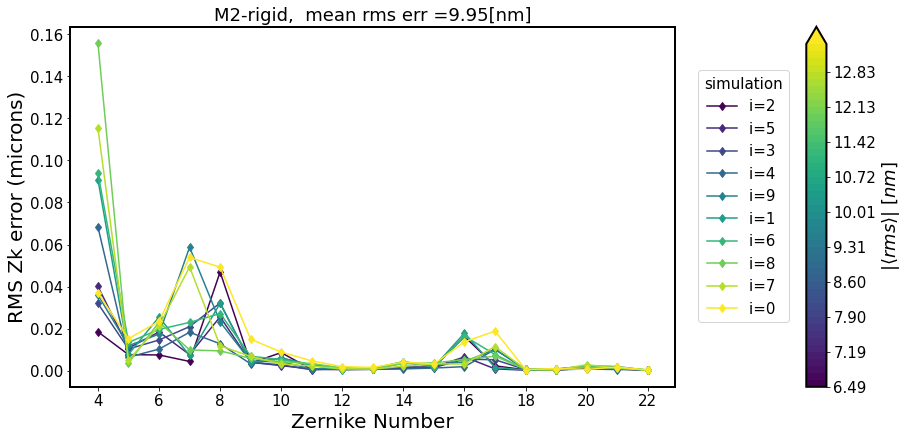

In [114]:
plot_rms(stats, source='M2-rigid', xpos=1.2)

For each simulation we calculated the median fitted Zernike coefficients across all donuts, `avgZk`. Given the `trueZk`, we calculate the residual for each simulation as `res = trueZk-avgZk` (plotted above and colored by absolute value of `res`) . We also calculate the mean of `res` across all simulations for a given setup. This is the number `m` in the title of each figure above. 


This shows that residuals overall are between on average 4 and 10 mm, smaller for `M2-rigid` where lower order Zks were excited, and larger for `Z4-Z22` where higher orders were excited. 

The rms error is between 5 and 30 nm rms, within the 200 nm goal of Manuel2010, which stated that the analysis "[...] expected residual wavefront error of 200 nm rms (root mean square) from atmospheric turbulence integrated over 15 seconds."  It is also a very similar range to  the typical baseline AOS simulation, being 0 to 30 nm rms. 

